     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 1.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9657 sha256=e95d7d2112abbdeadc9b83d35be4e88df1dce53f9cd7971993af44d9c944fa1e
  Stored in directory: /root/.cache/pip/wheels/8b/f1/7f/5c94f0a7a505ca1c81cd1d9208ae2064675d97582078e6c769
Successfully built wget




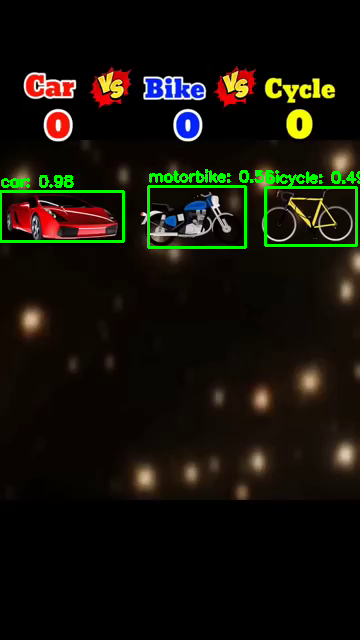

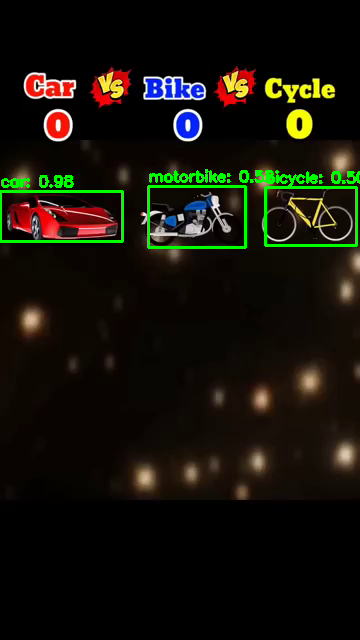

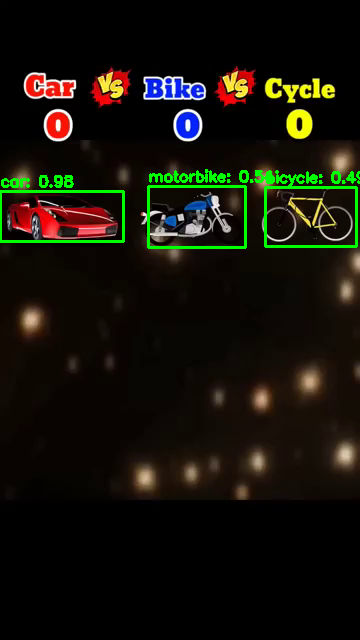

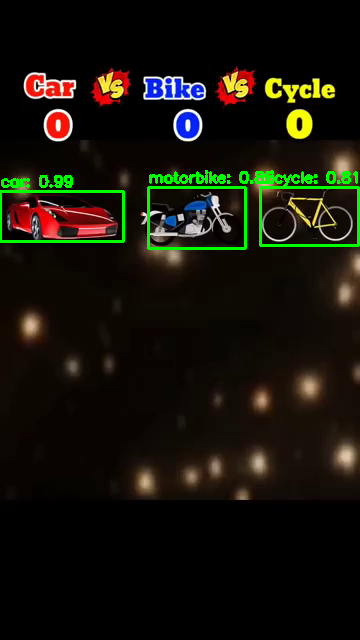

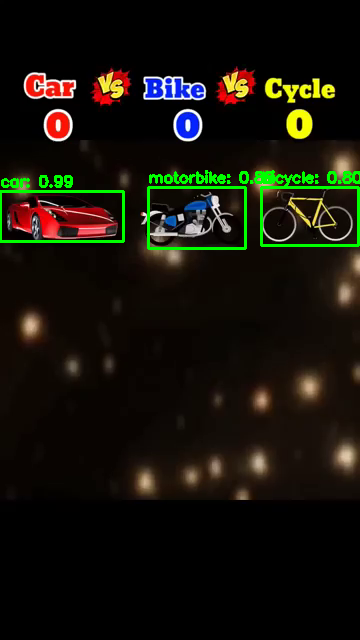

...

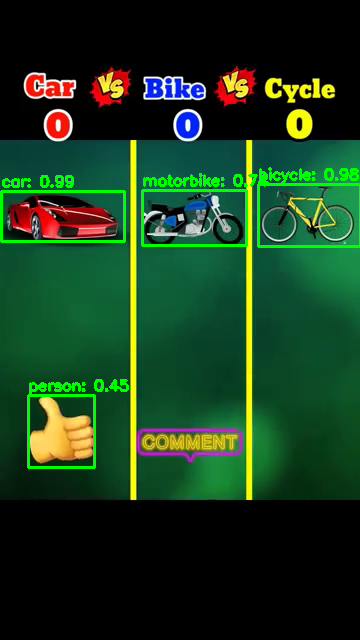

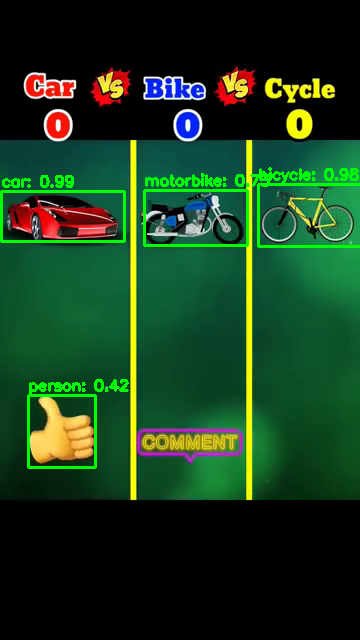

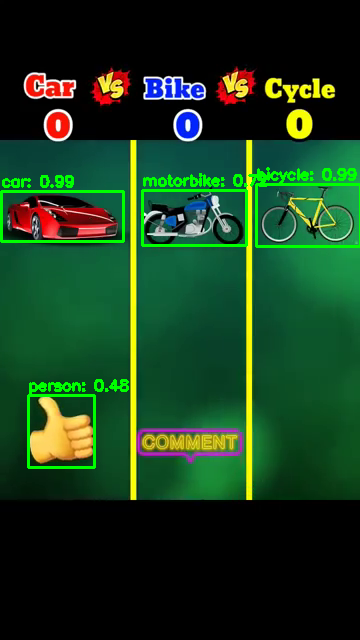

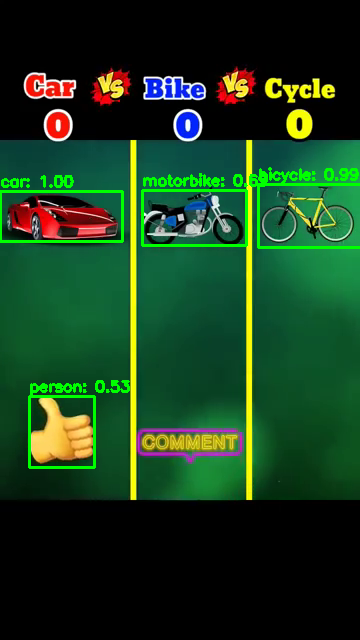

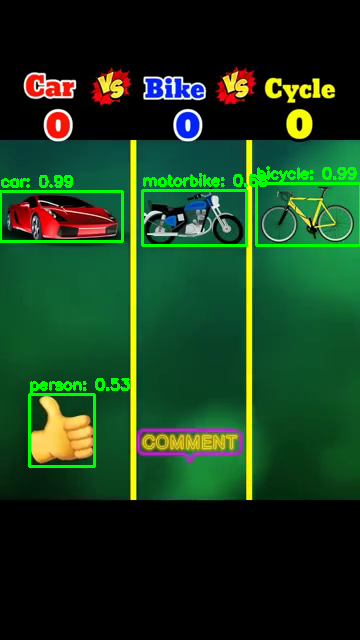

In [ ]:
%pip install pytube wget
import os
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
from pytube import YouTube
import wget

def download_files():
    if not os.path.exists("cfg"):
        os.makedirs("cfg")
    if not os.path.exists("data"):
        os.makedirs("data")

    if not os.path.exists("yolov3.weights"):
        print("Downloading YOLOv3 weights...")
        wget.download("https://pjreddie.com/media/files/yolov3.weights")

    if not os.path.exists("cfg/yolov3.cfg"):
        print("\nDownloading YOLOv3 configuration file...")
        wget.download("https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg", out="cfg/")

    if not os.path.exists("data/coco.names"):
        print("\nDownloading COCO dataset labels...")
        wget.download("https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names", out="data/")

def yolo_object_detection(frame, nms_threshold=0.3):
    net = cv2.dnn.readNet("yolov3.weights", "cfg/yolov3.cfg")

    with open("data/coco.names", "r") as f:
        classes = f.read().strip().split("\n")

    height, width = frame.shape[:2]
    blob = cv2.dnn.blobFromImage(frame, 1 / 255.0, (416, 416), swapRB=True, crop=False)
    net.setInput(blob)

    output_layer_names = net.getUnconnectedOutLayersNames()

    detections = net.forward(output_layer_names)

    class_ids = []
    confidences = []
    boxes = []

    for detection in detections:
        for obj in detection:
            scores = obj[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            if confidence > 0:
                center_x = int(obj[0] * width)
                center_y = int(obj[1] * height)
                w = int(obj[2] * width)
                h = int(obj[3] * height)

                x = center_x - w // 2
                y = center_y - h // 2

                class_ids.append(class_id)
                confidences.append(float(confidence))
                boxes.append([x, y, w, h])

    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.0, nms_threshold)

    for i in indices:
        x, y, w, h = boxes[i]
        class_id = class_ids[i]
        label = f"{classes[class_id]}: {confidences[i]:.2f}"
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(frame, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return frame

if __name__ == "__main__":
    download_files()

    video_url = 'https://www.youtube.com/watch?v=beQJR8V0_wc'

    yt = YouTube(video_url)
    video_stream = yt.streams.filter(progressive=True, file_extension="mp4").first()
    video_path = video_stream.download()

    cap = cv2.VideoCapture(video_path)

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        yolo_frame = yolo_object_detection(frame.copy())

        cv2_imshow(yolo_frame)

    cap.release()
    cv2.destroyAllWindows()
